In [ ]:
source("/ahg/regevdata/users/jklugham/projects/HD_ST/init.R")
library(grid)
library(cowplot)

#### Breast cancer

In [ ]:
#specify runs to compare/assess
runs=list("E2_unmodgtf_tnbc_hd"=c("E2_unmodgtf_tnbc_hd",0.05,0.7),
          "E2_unmodgtf_tnbc_low"=c("E2_unmodgtf_tnbc_low",0.05,0.7),
          "E2_unmodgtf_tnbc_seg"=c("E2_unmodgtf_tnbc_seg",0.05,0.7))

In [ ]:
runs=list("C1_unmodgtf_tnbc_hd_fastp_1000"=c("C1_unmodgtf_tnbc_hd_fastp_1000",0.05,0.7),"D1_unmodgtf_tnbc_hd_fastp_1000"=c("D1_unmodgtf_tnbc_hd_fastp_1000",0.05,0.7),
         "C1_unmodgtf_tnbc_low_fastp_1000"=c("C1_unmodgtf_tnbc_low_fastp_1000",0.05,0.7),"D1_unmodgtf_tnbc_low_fastp_1000"=c("D1_unmodgtf_tnbc_low_fastp_1000",0.05,0.7))

#### MOB

In [ ]:
#specify runs to compare/assess
runs=list("unmodgtf_li_seg_fastp_1000"=c("unmodgtf_li_seg_fastp_1000",0.01,0.1),
          "unmodgtf_li_low_fastp_1000"=c("unmodgtf_li_low_fastp_1000",0.01,0.1),
          "unmodgtf_li_hd_fastp_1000"=c("unmodgtf_li_hd_fastp_1000",0.01,0.1))

In [ ]:
runs=list("E1_unmodgtf_li_hd_fastp_100"=c("E1_unmodgtf_li_hd_fastp_100",0.01,0.1),"D1_unmodgtf_li_hd_fastp_100"=c("D1_unmodgtf_li_hd_fastp_100",0.01,0.1),
          "E1_unmodgtf_li_low_fastp_100"=c("E1_unmodgtf_li_low_fastp_100",0.01,0.1),"D1_unmodgtf_li_low_fastp_100"=c("D1_unmodgtf_li_low_fastp_100",0.01,0.1))

In [ ]:
runs=list("D1_unmodgtf_li_seg_fastp_100"=c("D1_unmodgtf_li_seg_fastp_100",0.01,0.1),"E1_unmodgtf_li_seg_fastp_100"=c("E1_unmodgtf_li_seg_fastp_100",0.01,0.1))

#### Compare both

In [4]:
runs=list("unmodgtf_li_hd_fastp_1000"=c("unmodgtf_li_hd_fastp_1000",0.01,0.1),
          "unmodgtf_li_low_fastp_1000"=c("unmodgtf_li_low_fastp_1000",0.01,0.1),
          "unmodgtf_li_seg_fastp_1000"=c("unmodgtf_li_seg_fastp_1000",0.01,0.1),
          "E2_unmodgtf_tnbc_hd"=c("E2_unmodgtf_tnbc_hd",0.05,0.7),
          "E2_unmodgtf_tnbc_low"=c("E2_unmodgtf_tnbc_low",0.05,0.7),
          "E2_unmodgtf_tnbc_seg"=c("E2_unmodgtf_tnbc_seg",0.05,0.7))

In [5]:
#get, compress and store data
ct=lapply(runs,function(x){
    sample=x[1]
    pval_thres=x[2]
    lk_norm_thres=x[3]
    dat=fread(paste0("results/ct_likelihoods_",sample,".tsv"))
    if("bin"%in%colnames(dat)){
        dat=dat[bin=="5x"]
    }
    
    dat[,N_ct:=sum(lk_norm>=lk_norm_thres&emp_pval_adjust_BH<=pval_thres&lk_rat>=0.8,na.rm = TRUE),by=c("x","y")]
    dat[,secondary_ct_valid:=ifelse(lk_norm[ClusterName==second_best_ct]>=lk_norm_thres&
                                    emp_pval_adjust_BH[ClusterName==second_best_ct]<=pval_thres&
                                    lk_rat[ClusterName==second_best_ct]>=0.8,TRUE,FALSE),by=c("x","y")]
    dat[,ct_simpl:=ifelse(grepl("_",ClusterName),unlist(lapply(strsplit(as.character(ClusterName),"_"),"[[",2)),ClusterName),]
    dat[,sec_simpl:=ifelse(grepl("_",second_best_ct),unlist(lapply(strsplit(as.character(second_best_ct),"_"),"[[",2)),second_best_ct),]
    dat_red=dat[,.SD[which.max(lk)],by=c("x","y")]
    rm(dat)
    dat_red[,valid:=ifelse(lk_norm>=lk_norm_thres&emp_pval_adjust_BH<=pval_thres,TRUE,FALSE),by=1:nrow(dat_red)]
    print(sample)
    print(dat_red[,.N,by=N_ct][order(N_ct)])
    print(dat_red[,sum(N_ct==1)/length(N_ct),])
    return(list(dat_red,x))
    
})

[1] "unmodgtf_li_hd_fastp_1000"
   N_ct     N
1:    0 64320
2:    1 36072
3:    2 10691
4:    3  2513
5:    4   488
6:    5    91
7:    6     6
[1] 0.3159195
[1] "unmodgtf_li_low_fastp_1000"
   N_ct     N
1:    0  9140
2:    1 18767
3:    2  3607
4:    3   602
5:    4    79
6:    5    12
7:    6     3
[1] 0.5826451
[1] "unmodgtf_li_seg_fastp_1000"
   N_ct     N
1:    0 11396
2:    1 17242
3:    2  3844
4:    3   799
5:    4   125
6:    5    21
7:    6     5
[1] 0.5157334
[1] "E2_unmodgtf_tnbc_hd"
   N_ct      N
1:    0 131911
2:    1  28905
[1] 0.1797396
[1] "E2_unmodgtf_tnbc_low"
   N_ct     N
1:    0  7066
2:    1 21730
[1] 0.7546187
[1] "E2_unmodgtf_tnbc_seg"
   N_ct     N
1:    0 15162
2:    1 22582
[1] 0.5982938


### Posterior probability/ p-value distributions

Note: emp p-values of 0 (due to limited number or iterations) are not displayed

In [6]:
pl=lapply(ct,function(x)ggplot(x[1][[1]],aes(x=lk_norm,y=-log10(emp_pval_adjust_BH)))+
          geom_density2d(lwd=0.5)+
          geom_hline(yintercept = -log10(as.numeric(x[2][[1]][2])),col="red")+
          geom_vline(xintercept = as.numeric(x[2][[1]][3]),col="red")+
          xlab("Posterior probability")+ylab("-log10(adj.p.value)")+xlim(c(0,1)))

Warning message:
"Removed 26305 rows containing non-finite values (stat_density2d)."Warning message:
"Removed 18857 rows containing non-finite values (stat_density2d)."Warning message:
"Removed 15053 rows containing non-finite values (stat_density2d)."Warning message:
"Removed 10972 rows containing non-finite values (stat_density2d)."Warning message:
"Removed 13658 rows containing non-finite values (stat_density2d)."Warning message:
"Removed 11736 rows containing non-finite values (stat_density2d)."

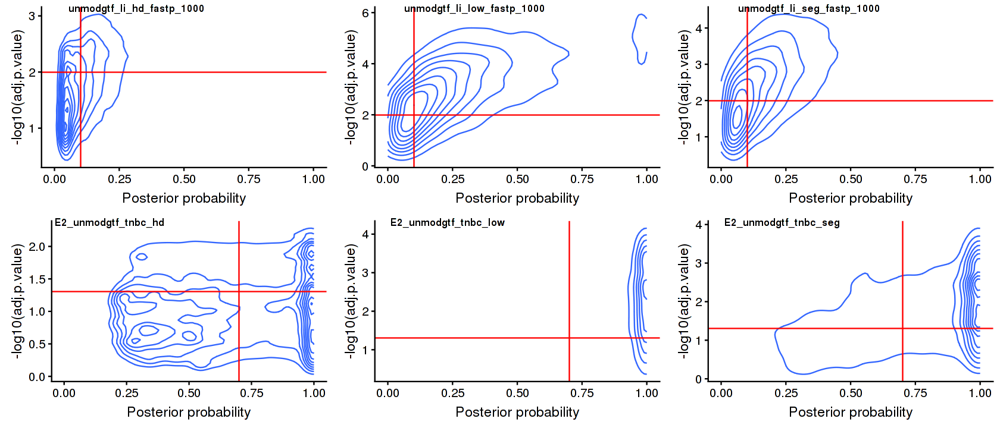

In [11]:
options(repr.plot.width=14, repr.plot.height=6)
plot_grid(plotlist = pl,ncol = length(pl)/2,labels = names(pl),label_size = 10)

### P-value vs number of UMIs per barcode/bin

In [17]:
pl=lapply(ct,function(dat)ggplot(dat[1][[1]],aes(x=count,y=-log10(emp_pval_adjust_BH+min(dat[1][[1]]$emp_pval_adjust_BH[which(dat[1][[1]]$emp_pval_adjust_BH>0)]))))+
          geom_point(aes(col=ct_simpl),alpha=0.5)+
          xlab("UMIs per barcode")+ylab("-log10(adj.p.value)"))

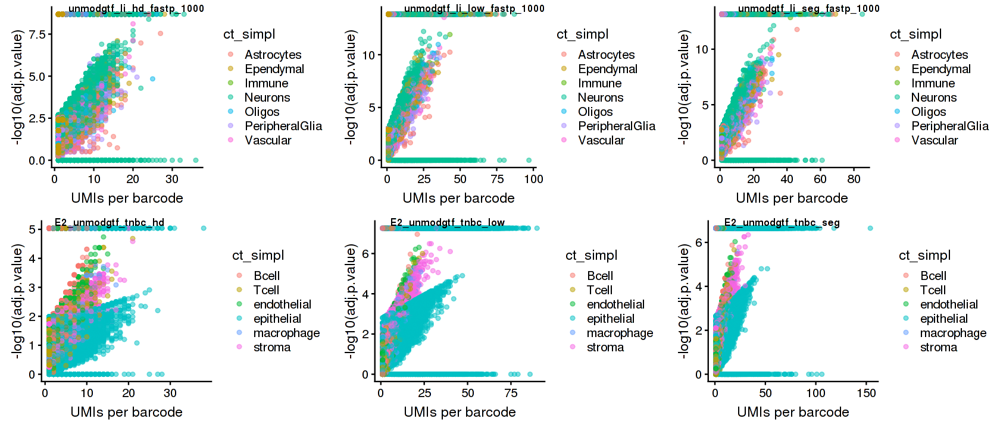

In [17]:
options(repr.plot.width=14, repr.plot.height=6)
plot_grid(plotlist = pl,ncol = length(pl)/2,labels = names(pl),label_size = 10)

### Posterior probability vs number of UMIs per barcode/bin

In [20]:
pl=lapply(ct,function(x)ggplot(x[1][[1]],aes(x=count,group=count,y=lk_norm))+
          geom_boxplot()+
          xlab("UMIs per barcode")+ylab("Posterior probability")+ylim(c(0,1)))

Warning message:
"Removed 1018 rows containing non-finite values (stat_boxplot)."Warning message:
"Removed 1156 rows containing non-finite values (stat_boxplot)."Warning message:
"Removed 706 rows containing non-finite values (stat_boxplot)."Warning message:
"Removed 850 rows containing non-finite values (stat_boxplot)."Warning message:
"Removed 930 rows containing non-finite values (stat_boxplot)."Warning message:
"Removed 706 rows containing non-finite values (stat_boxplot)."

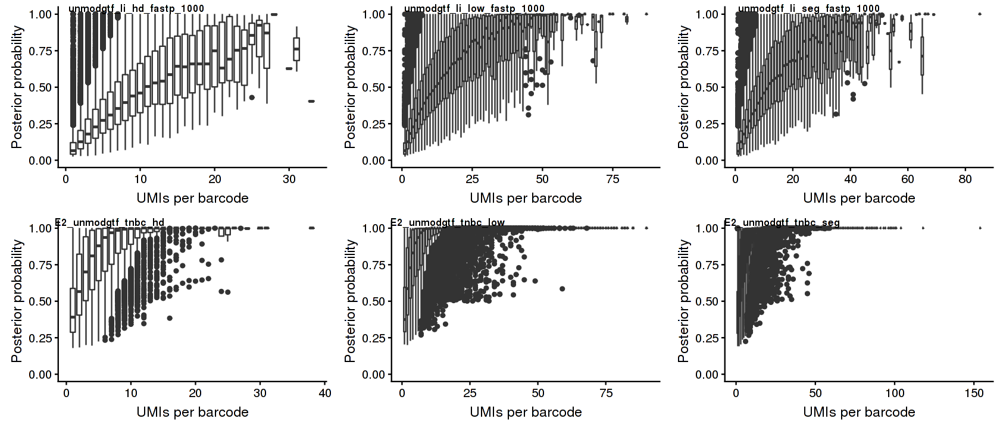

In [22]:
options(repr.plot.width=14, repr.plot.height=6)
plot_grid(plotlist = pl,ncol = length(pl)/2,labels = names(pl),label_size = 10)

### Number of valid assigned cell types 

In [23]:
pl=lapply(ct,function(x)ggplot(x[1][[1]][,.N,by=c("N_ct","count")][order(count,decreasing=FALSE)],aes(x=factor(N_ct),y=N,fill=count))+
          geom_bar(stat="identity")+xlab("Number of valid cell types")+ylab("Number of barcodes")+scale_fill_gradientn(colours = c("blue","yellow","red")))

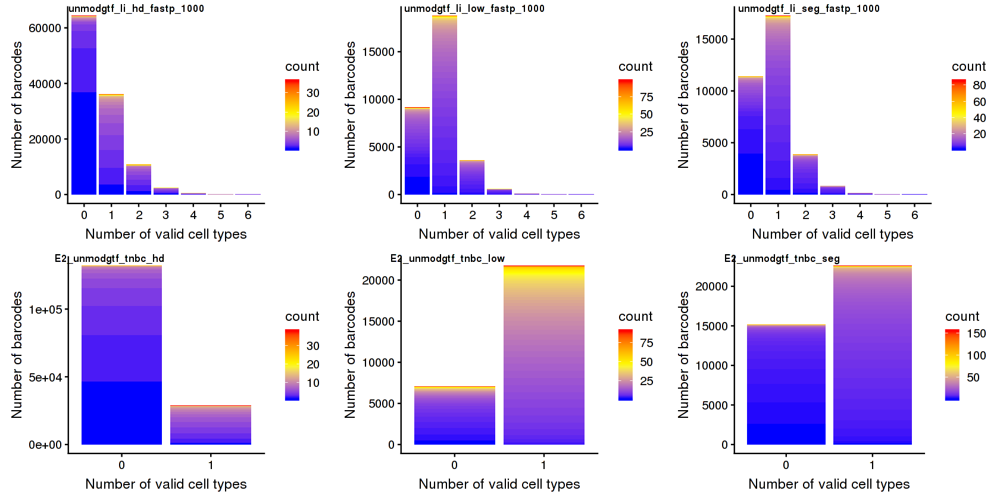

In [26]:
options(repr.plot.width=14, repr.plot.height=7)
plot_grid(plotlist = pl,ncol = length(pl)/2,labels = names(pl),label_size = 10)

### Ambiguous cell type assignemnts

In [27]:
pl=lapply(ct[1],function(x)ggplot(x[1][[1]][,c("ClusterName","second_best_ct"):=
                                              list(factor(ClusterName,levels=unique(ClusterName[order(ct_simpl,as.character(ClusterName))])),
                                                   factor(second_best_ct,levels=unique(second_best_ct[order(sec_simpl,as.character(second_best_ct))]))),][secondary_ct_valid==TRUE],
                                    aes(x=ClusterName,y=second_best_ct))+
          geom_count(pch=21,color="black",aes(size = stat(prop),fill = stat(prop), group = ClusterName))+
          theme(axis.text.x = element_text(angle = 60, vjust = 1, hjust=1))+
          scale_fill_gradient(high="red",low="white")+
          ylab("Secondary cell type")+xlab("Primary cell type")+coord_fixed())

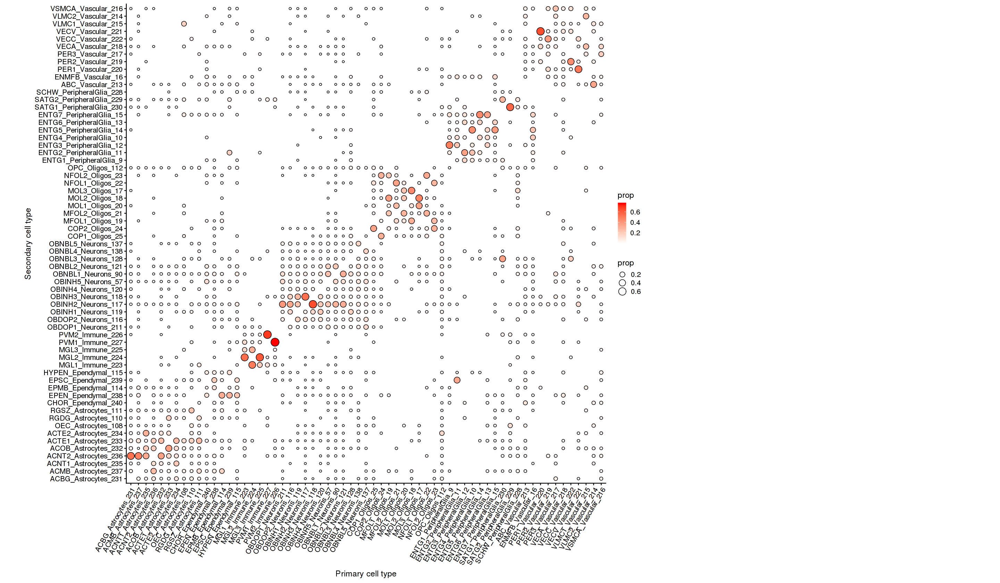

In [28]:
options(repr.plot.width=24, repr.plot.height=14)
plot_grid(plotlist = pl,ncol = 2,rel_widths = c(2,1))

### UMI/gene stats per experiment

In [29]:
pl=lapply(ct,function(x)ggplot(x[1][[1]])+geom_bar(fill="white",col="black",aes(x=count))+
          geom_vline(aes(xintercept = mean(count)), color = "red", linetype = "dashed")
          +ylab("Number of barcodes")+xlab("Number of UMIs"))

In [31]:
lapply(ct,function(x)x[1][[1]][,.(meanUMIs=mean(count),N_bc=length(count),meanGenes=mean(unlist(lapply(umi_distrib,function(x)length(eval(parse(text=x)))))))])

meanUMIs,N_bc,meanGenes
2.962805,114181,2.810511
meanUMIs,N_bc,meanGenes
10.50283,32210,9.931264
meanUMIs,N_bc,meanGenes
7.074509,33432,6.690237
meanUMIs,N_bc,meanGenes
3.063371,160816,2.951535
meanUMIs,N_bc,meanGenes
17.1079,28796,16.30542
meanUMIs,N_bc,meanGenes


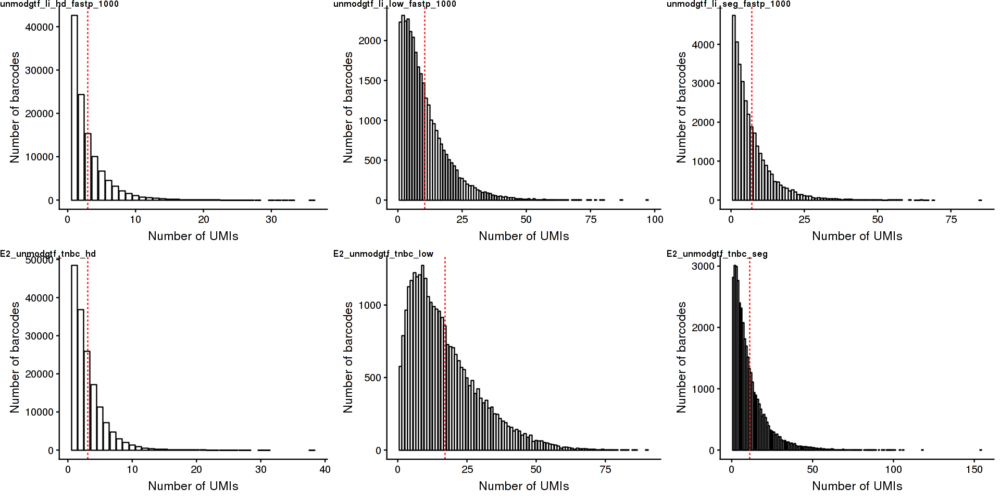

In [33]:
options(repr.plot.width=16, repr.plot.height=8)
plot_grid(plotlist = pl,ncol = length(pl)/2,labels = names(pl),label_y=1,hjust = 0,vjust=1,label_size = 10)

### Spatial distribution of all cell types together

In [36]:
pl=lapply(ct,function(dat)ggplot(dat[1][[1]][lk_norm>=as.numeric(dat[2][[1]][3])&emp_pval_adjust_BH<=as.numeric(dat[2][[1]][2]),],aes(x=x,y=y,col=ct_simpl,alpha=lk_norm))+geom_point()+coord_fixed())

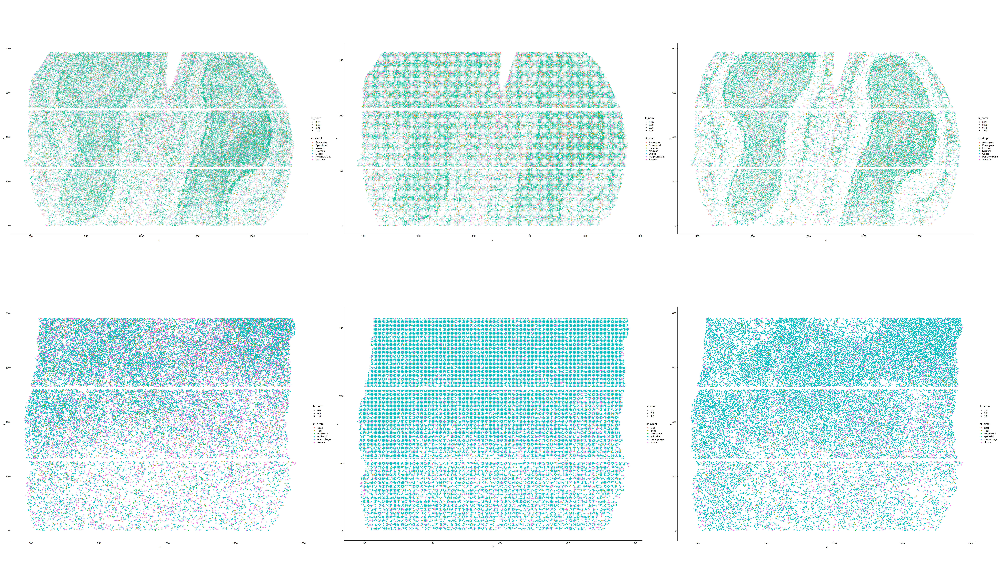

In [37]:
options(repr.plot.width=70, repr.plot.height=40)
plot_grid(plotlist = pl,ncol = length(pl)/2,hjust = -1)

### Spatial distribution of selected cell types

In [38]:
pl=lapply(ct[c(1,4)],function(dat)ggplot(dat[1][[1]][lk_norm>=as.numeric(dat[2][[1]][3])&emp_pval_adjust_BH<=as.numeric(dat[2][[1]][2])&grepl("OBINH2|OBNBL1|epithelial|macrophage",ClusterName),],
                                    aes(x=x,y=y,alpha=lk_norm),col="black")+facet_wrap(~ClusterName,ncol=4)+geom_point()+coord_fixed())

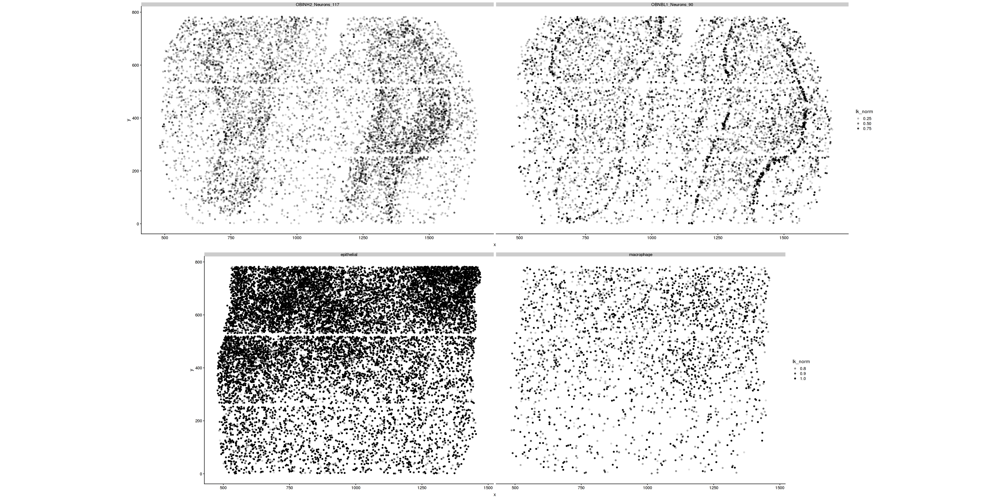

In [39]:
options(repr.plot.width=40, repr.plot.height=20)
plot_grid(plotlist = pl,ncol = 1,hjust = -1)

### Plot spatial cell type enrichment results

In [54]:
enrich_tags=list("unmodgtf_li_seg_Pval","E2_tnbc_Pval_seg")

In [55]:
enrich_list=lapply(enrich_tags,function(x)fread(paste0("results/ct_anat_enrich_",x,".tsv")))

In [56]:
pl=lapply(enrich_list,function(res)ggplot(res[p.value.adjust<0.01],aes(x=cell_type,y=layer,fill=log10(p.value.adjust)))+
          geom_tile()+theme(axis.text.x = element_text(angle = 90, hjust = 1,vjust=0.5))+scale_fill_gradient(low="red",high="black"))

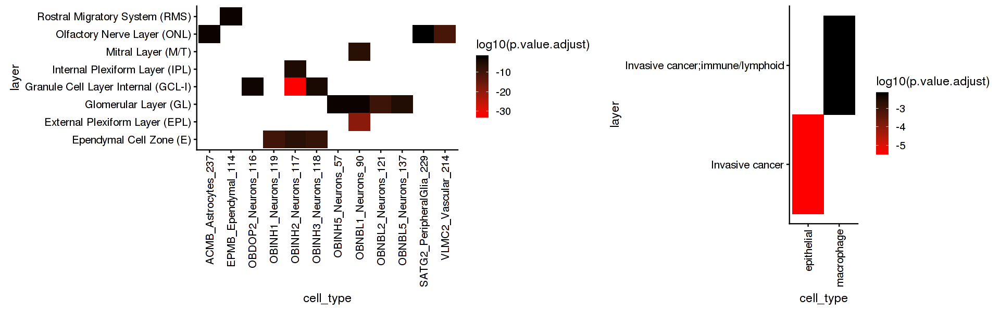

In [58]:
options(repr.plot.width=16, repr.plot.height=5)
plot_grid(plotlist = pl,ncol = 2,rel_widths = c(3,2))